# Descarga del dataset y labels

In [ ]:
!pip install --quiet kagglehub[pandas-datasets]

import kagglehub
from pathlib import Path

LABELS_DIR = kagglehub.dataset_download(
    "ambityga/imagenet100", path= "Labels.json"
)
print("Archivos descargados en:", LABELS_DIR)


VAL_DIR = kagglehub.dataset_download(
    "ambityga/imagenet100", path= "val.X"
)
print("Archivos descargados en:", VAL_DIR)

Using Colab cache for faster access to the 'imagenet100' dataset.
Archivos descargados en: /kaggle/input/imagenet100/Labels.json
Using Colab cache for faster access to the 'imagenet100' dataset.
Archivos descargados en: /kaggle/input/imagenet100/val.X


# generar clase

In [ ]:
import os
from PIL import Image
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms

class ImageNet100ValDataset(Dataset):
    def __init__(self, root_dir, transform=None):
        self.root_dir = root_dir
        self.transform = transform
        self.class_to_idx = {c: i for i, c in enumerate(sorted(os.listdir(root_dir)))}
        self.samples = [
            (os.path.join(root_dir, c, f), self.class_to_idx[c])
            for c in self.class_to_idx
            for f in os.listdir(os.path.join(root_dir, c))
            if f.lower().endswith(('.jpg', '.jpeg', '.png', '.jpeg'))
        ]

    def __len__(self):
        return len(self.samples)

    def __getitem__(self, idx):
        path, label = self.samples[idx]
        img = Image.open(path).convert("RGB")
        if self.transform:
            img = self.transform(img)
        return img, label


transform = transforms.Compose([
    transforms.Resize(256),                  # Redimensiona el lado más corto a 256 px
    transforms.CenterCrop(224),              # Recorta el centro a 224×224 (tamaño típico de ImageNet)
    transforms.ToTensor(),                   # Convierte a tensor (0–1)
    transforms.Normalize(                    # Normaliza con medias y desv. estándar de ImageNet
        mean=[0.485, 0.456, 0.406],
        std =[0.229, 0.224, 0.225]
    )
])

val_dataset = ImageNet100ValDataset(VAL_DIR, transform=transform)
val_loader  = DataLoader(val_dataset, batch_size=64, shuffle=False, num_workers=2)

print("Total imágenes de validación:", len(val_dataset))


Total imágenes de validación: 5000


# Ver las clases

In [ ]:
import json

with open(LABELS_DIR) as f:
    labels = json.load(f)

print(f"El Dataset tiene {len(labels)} etiquetas\n")

for i, (fname, label) in enumerate(labels.items()):
    print(fname, label)

El Dataset tiene 100 etiquetas

n01968897 chambered nautilus, pearly nautilus, nautilus
n01770081 harvestman, daddy longlegs, Phalangium opilio
n01818515 macaw
n02011460 bittern
n01496331 electric ray, crampfish, numbfish, torpedo
n01847000 drake
n01687978 agama
n01740131 night snake, Hypsiglena torquata
n01537544 indigo bunting, indigo finch, indigo bird, Passerina cyanea
n01491361 tiger shark, Galeocerdo cuvieri
n02007558 flamingo
n01735189 garter snake, grass snake
n01630670 common newt, Triturus vulgaris
n01440764 tench, Tinca tinca
n01819313 sulphur-crested cockatoo, Kakatoe galerita, Cacatua galerita
n02002556 white stork, Ciconia ciconia
n01667778 terrapin
n01755581 diamondback, diamondback rattlesnake, Crotalus adamanteus
n01924916 flatworm, platyhelminth
n01751748 sea snake
n01984695 spiny lobster, langouste, rock lobster, crawfish, crayfish, sea crawfish
n01729977 green snake, grass snake
n01614925 bald eagle, American eagle, Haliaeetus leucocephalus
n01608432 kite
n01443537 

# Vemos una muestra de cada clases

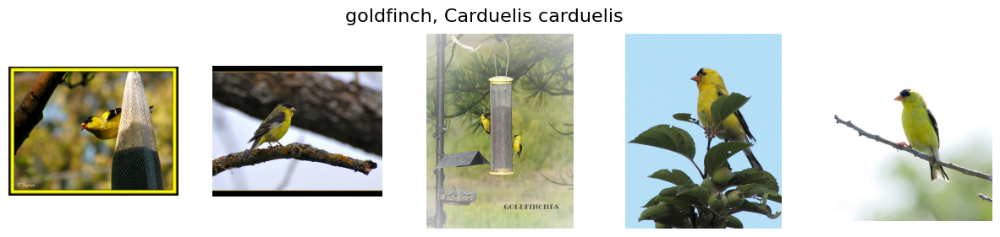

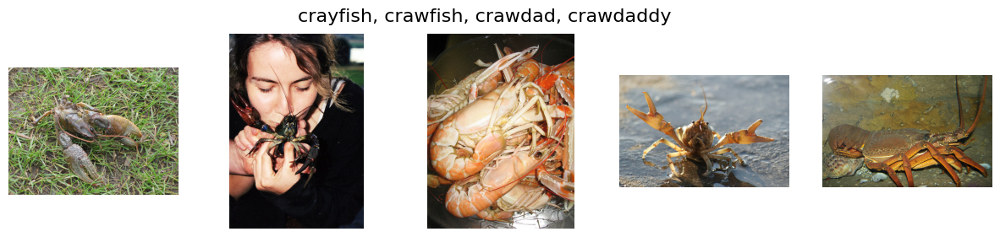

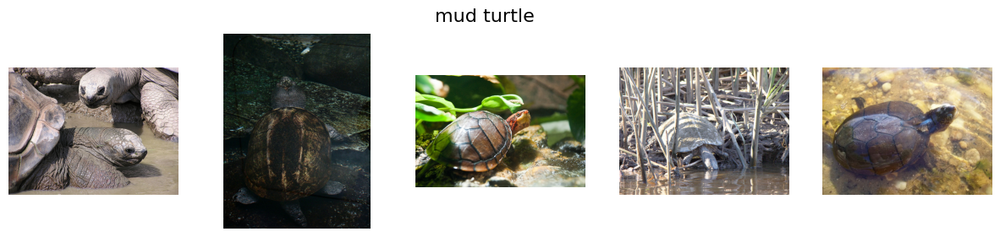

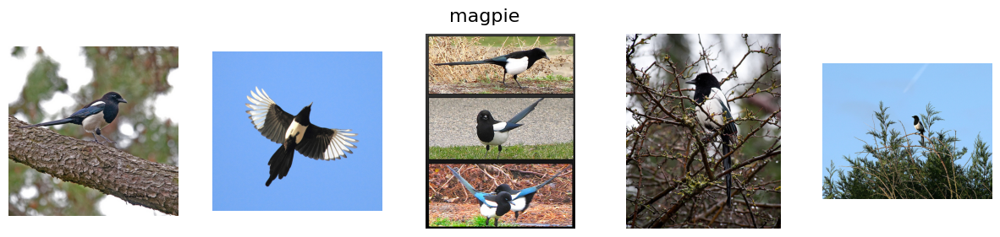

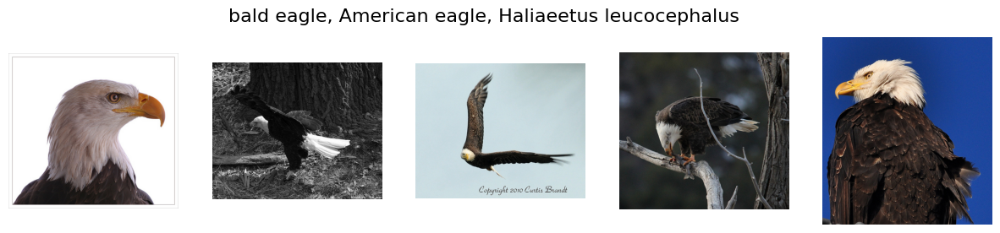

...

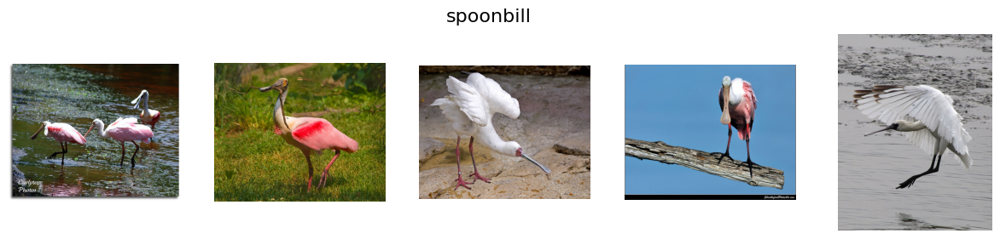

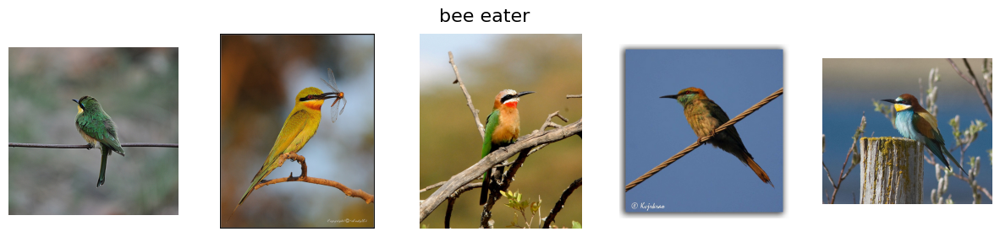

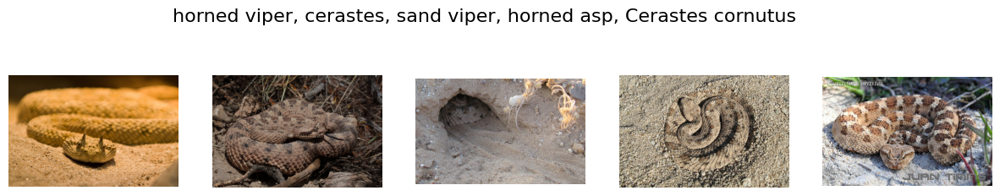

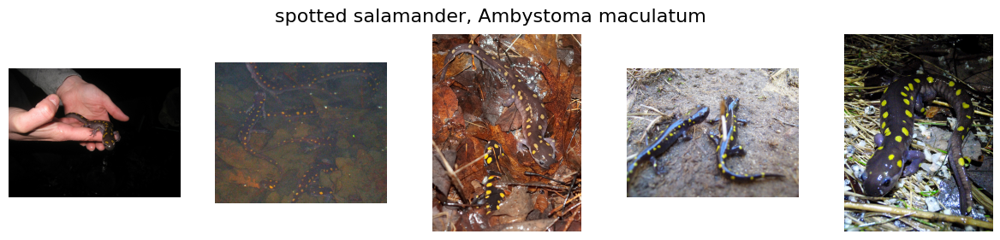

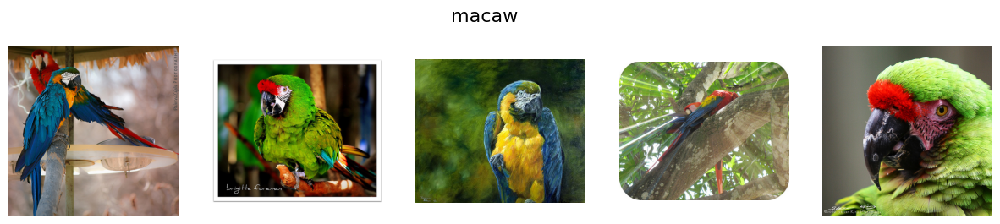

In [ ]:
from collections import defaultdict
import matplotlib.pyplot as plt

wnid_to_images = defaultdict(list)

for class_dir in Path(VAL_DIR).iterdir():
    if class_dir.is_dir():
        wnid = class_dir.name
        for img_file in class_dir.iterdir():
            if img_file.suffix.lower() in ['.jpg', '.jpeg', '.png']:
                wnid_to_images[wnid].append(img_file)


for wnid, images in wnid_to_images.items():
    plt.figure(figsize=(15,3))
    class_name = labels.get(wnid, wnid)
    plt.suptitle(f"{class_name}", fontsize=16)

    for i, img_path in enumerate(images[:5]):  # solo 5 imágenes
        img = Image.open(img_path).convert("RGB")
        plt.subplot(1,5,i+1)
        plt.imshow(img)
        plt.axis('off')

    plt.show()


# cantidad de m uestras por clase

In [ ]:

class_counts = {wnid: len(imgs) for wnid, imgs in wnid_to_images.items()}

class_counts = dict(sorted(class_counts.items(), key=lambda x: x[1], reverse=True))

print(f"Total de clases: {len(class_counts)}")

for wnid, count in list(class_counts.items()):
    nombre = labels.get(wnid, wnid)
    print(f"{wnid:>10}  ({nombre}): {count} imágenes")

Total de clases: 100
 n01531178  (goldfinch, Carduelis carduelis): 50 imágenes
 n01985128  (crayfish, crawfish, crawdad, crawdaddy): 50 imágenes
 n01667114  (mud turtle): 50 imágenes
 n01582220  (magpie): 50 imágenes
 n01614925  (bald eagle, American eagle, Haliaeetus leucocephalus): 50 imágenes
 n01440764  (tench, Tinca tinca): 50 imágenes
 n02058221  (albatross, mollymawk): 50 imágenes
 n01664065  (loggerhead, loggerhead turtle, Caretta caretta): 50 imágenes
 n01677366  (common iguana, iguana, Iguana iguana): 50 imágenes
 n01829413  (hornbill): 50 imágenes
 n01494475  (hammerhead, hammerhead shark): 50 imágenes
 n01950731  (sea slug, nudibranch): 50 imágenes
 n01498041  (stingray): 50 imágenes
 n01806143  (peacock): 50 imágenes
 n01968897  (chambered nautilus, pearly nautilus, nautilus): 50 imágenes
 n02077923  (sea lion): 50 imágenes
 n01795545  (black grouse): 50 imágenes
 n01632777  (axolotl, mud puppy, Ambystoma mexicanum): 50 imágenes
 n01698640  (American alligator, Alligator m